Practical lesson
**Sébastien Harispe**

<h1><center>Supervised Learning: <br/> Classification &amp; Regression with Scikit Learn</center></h1>


# Aim of the practical lesson
In this practical lesson we will:
* Use scikit-learn to solve simple classification and regression problems.
* Learn (i) how to apply feature transformations, (ii) how to deal with multiclass classification problems using binary classification algorithms, and (iii) how to compare models using k-fold cross validation.

We will also use the following Python libraries: 
* [Numpy](https://numpy.org/): a scientific library
* [Pandas](https://pandas.pydata.org/): a data analysis and manipulation library.
* [Matplotlib](https://matplotlib.org/): a visualization library. 

If you don't want to use [Google Colab](https://colab.research.google.com/), we recommand you to use [Anaconda](https://www.anaconda.com/) to manage your install (pip can also simply be used).

We next consider the following imports:

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import sklearn
from IPython.display import display

C:\Users\lenac\AppData\Local\Temp\ipykernel_60284\1162194208.py:3: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


## Scikit-learn

https://scikit-learn.org

```
Scikit-learn: Machine Learning in Python
* Simple and efficient tools for data mining and data analysis
* Accessible to everybody, and reusable in various contexts
* Built on NumPy, SciPy, and matplotlib
* Open source, commercially usable - BSD license
```

Scikit-learn is an easy-to-use and powerful Python library to perform supervised learning (classification, regression) and unsupervised learning tasks (clustering, dimensionality reduction). It also provides powerful tools to preprocess data and to select models. 


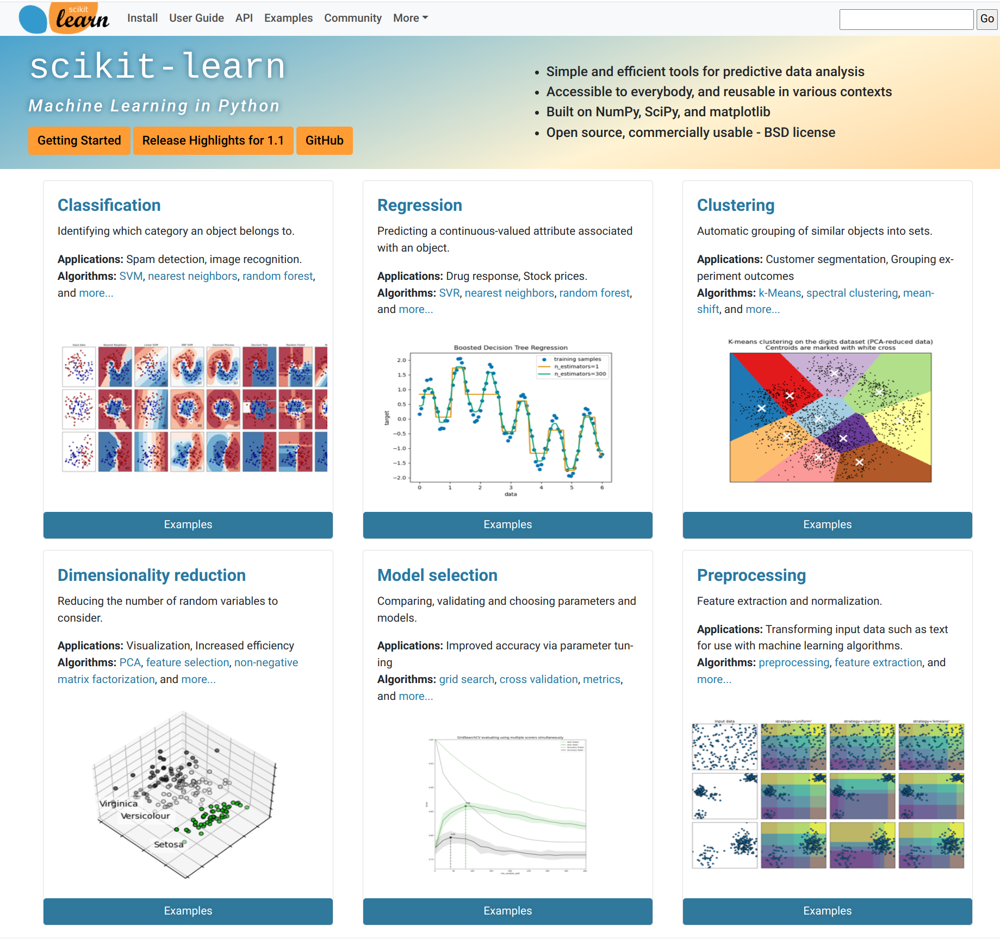

### Datasets



Scikit-learn gives access to several datasets you can use to practice your skills and eventually test your own algorithms.

https://scikit-learn.org/stable/datasets.html


In [2]:
from sklearn.datasets import load_breast_cancer
bcd = load_breast_cancer() # bcd stands for breast cancer dataset
print(f"Keys of Breast Cancer Dataset: {bcd.keys()}")

Keys of Breast Cancer Dataset: dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])


The entry associated to DESCR provides a short description of the dataset

In [3]:
print(bcd["DESCR"])

.. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

:Number of Instances: 569

:Number of Attributes: 30 numeric, predictive attributes and the class

:Attribute Information:
    - radius (mean of distances from center to points on the perimeter)
    - texture (standard deviation of gray-scale values)
    - perimeter
    - area
    - smoothness (local variation in radius lengths)
    - compactness (perimeter^2 / area - 1.0)
    - concavity (severity of concave portions of the contour)
    - concave points (number of concave portions of the contour)
    - symmetry
    - fractal dimension ("coastline approximation" - 1)

    The mean, standard error, and "worst" or largest (mean of the three
    worst/largest values) of these features were computed for each image,
    resulting in 30 features.  For instance, field 0 is Mean Radius, field
    10 is Radius SE, field 20 is Worst Radius.

    - 

**Exercise 1.1** 

Show the label names 

In [4]:
# TODO
bcd.target_names

array(['malignant', 'benign'], dtype='<U9')

Recall that since we are only considering two classes we are in a binary classification setting.

**Exercise 1.2** 

Show the names of the features 

In [5]:
# TODO
bcd.feature_names

array(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error',
       'fractal dimension error', 'worst radius', 'worst texture',
       'worst perimeter', 'worst area', 'worst smoothness',
       'worst compactness', 'worst concavity', 'worst concave points',
       'worst symmetry', 'worst fractal dimension'], dtype='<U23')

**Exercise 1.3** 

Show the shape of the datastructure storing the data. 
You can use `type(inst)` to access the type of the instance `inst`.

Additional information: https://numpy.org/doc/stable/reference/generated/numpy.ndarray.html

In [6]:
# TODO
bcd.data.shape

(569, 30)

569 labeled examples, each example represented as a vector of 30 numerical features.

**Exercise 1.4** 

Print the data associated to the 14th element of the dataset

In [7]:
# TODO
bcd.data[13]

array([1.585e+01, 2.395e+01, 1.037e+02, 7.827e+02, 8.401e-02, 1.002e-01,
       9.938e-02, 5.364e-02, 1.847e-01, 5.338e-02, 4.033e-01, 1.078e+00,
       2.903e+00, 3.658e+01, 9.769e-03, 3.126e-02, 5.051e-02, 1.992e-02,
       2.981e-02, 3.002e-03, 1.684e+01, 2.766e+01, 1.120e+02, 8.765e+02,
       1.131e-01, 1.924e-01, 2.322e-01, 1.119e-01, 2.809e-01, 6.287e-02])

**Exercise 1.5** 

Show the 10 first inputs of the dataset


In [8]:
# TODO
print(bcd.data[:10].shape)
bcd.data[:10]

(10, 30)


array([[1.799e+01, 1.038e+01, 1.228e+02, 1.001e+03, 1.184e-01, 2.776e-01,
        3.001e-01, 1.471e-01, 2.419e-01, 7.871e-02, 1.095e+00, 9.053e-01,
        8.589e+00, 1.534e+02, 6.399e-03, 4.904e-02, 5.373e-02, 1.587e-02,
        3.003e-02, 6.193e-03, 2.538e+01, 1.733e+01, 1.846e+02, 2.019e+03,
        1.622e-01, 6.656e-01, 7.119e-01, 2.654e-01, 4.601e-01, 1.189e-01],
       [2.057e+01, 1.777e+01, 1.329e+02, 1.326e+03, 8.474e-02, 7.864e-02,
        8.690e-02, 7.017e-02, 1.812e-01, 5.667e-02, 5.435e-01, 7.339e-01,
        3.398e+00, 7.408e+01, 5.225e-03, 1.308e-02, 1.860e-02, 1.340e-02,
        1.389e-02, 3.532e-03, 2.499e+01, 2.341e+01, 1.588e+02, 1.956e+03,
        1.238e-01, 1.866e-01, 2.416e-01, 1.860e-01, 2.750e-01, 8.902e-02],
       [1.969e+01, 2.125e+01, 1.300e+02, 1.203e+03, 1.096e-01, 1.599e-01,
        1.974e-01, 1.279e-01, 2.069e-01, 5.999e-02, 7.456e-01, 7.869e-01,
        4.585e+00, 9.403e+01, 6.150e-03, 4.006e-02, 3.832e-02, 2.058e-02,
        2.250e-02, 4.571e-03, 2.357e

In [9]:
print(f"Is the number of labels equal to the number of input vectors?  {len(bcd.data) ==  len(bcd.target)}")

Is the number of labels equal to the number of input vectors?  True


**Exercise 1.6**

Compute the average value of the feature 'mean area' 

In [10]:
# TODO
print(bcd.feature_names)
np.average(bcd.data[:,3], axis=0)

['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']


654.8891036906855

## Dataset Insight

This section does not contain exercise. 
Just quickly read the source code and try understanding it (broad picture).

Let's first analyse the dataset to try to get some insights about it.


In [11]:
bc_df = pd.DataFrame(bcd.data, columns=bcd.feature_names)

Using Pandas we can easily visualize the relationships between pairs of features by plotting the scatter plots of each pairs in the cartesian product of features. 
[(documentation)](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.plotting.scatter_matrix.html)

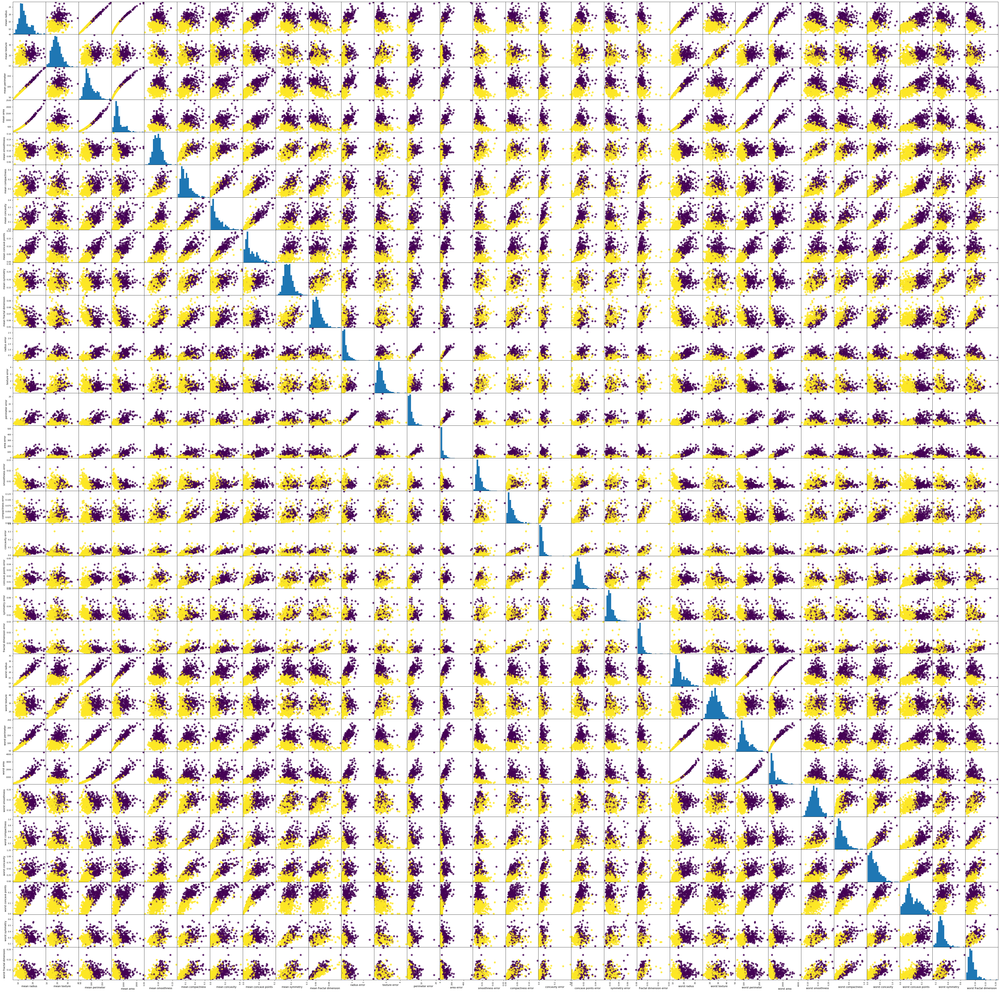

In [12]:
%matplotlib inline
_ = pd.plotting.scatter_matrix(bc_df,c=bcd.target, figsize=(70,70), marker='o',hist_kwds={'bins':20},s=60,alpha=.8)

Using such a visualization we can visually analyze the correlations between the features.

Let's analyze specific features. Below we recall the features specified in the dataset.

In [13]:
print("Keys of Breast Cancer Dataset: {}".format(bcd.keys()))
print(bcd.target_names)
print(bcd.feature_names)

Keys of Breast Cancer Dataset: dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])
['malignant' 'benign']
['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']


Below we propose another visualization showing the distributions of feature values, as well as some scatter plots for specific pairs of features.

<Axes: xlabel='mean perimeter', ylabel='mean area'>

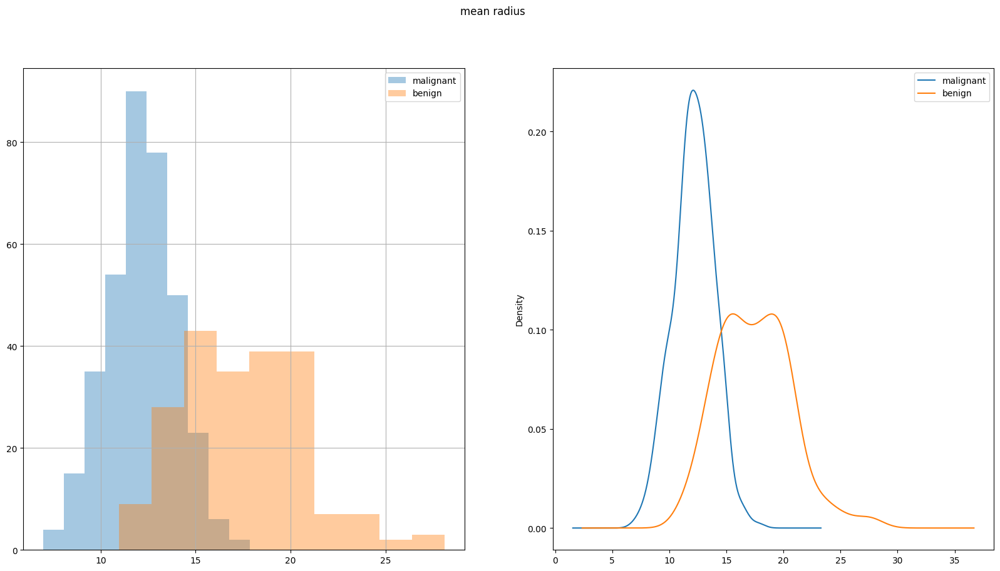

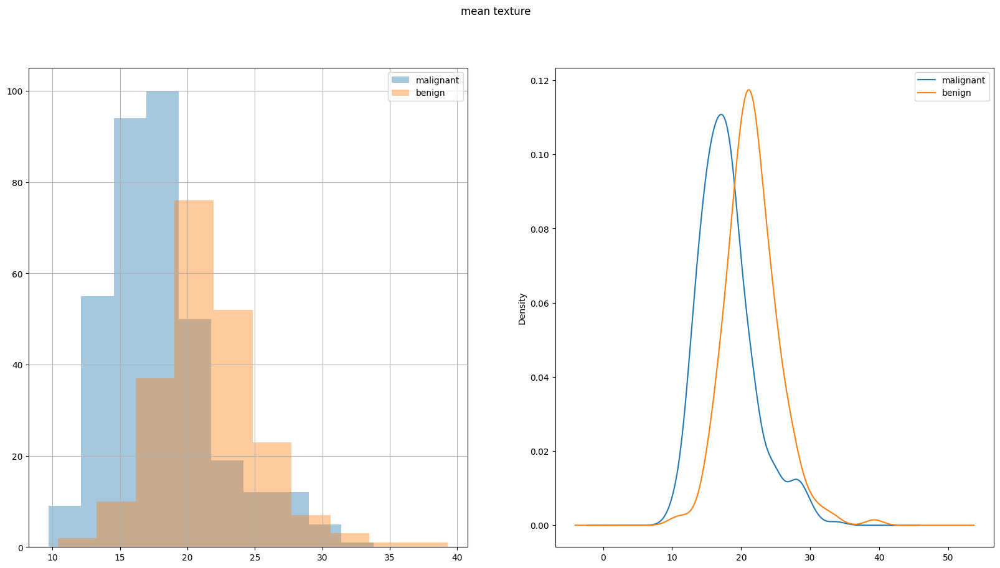

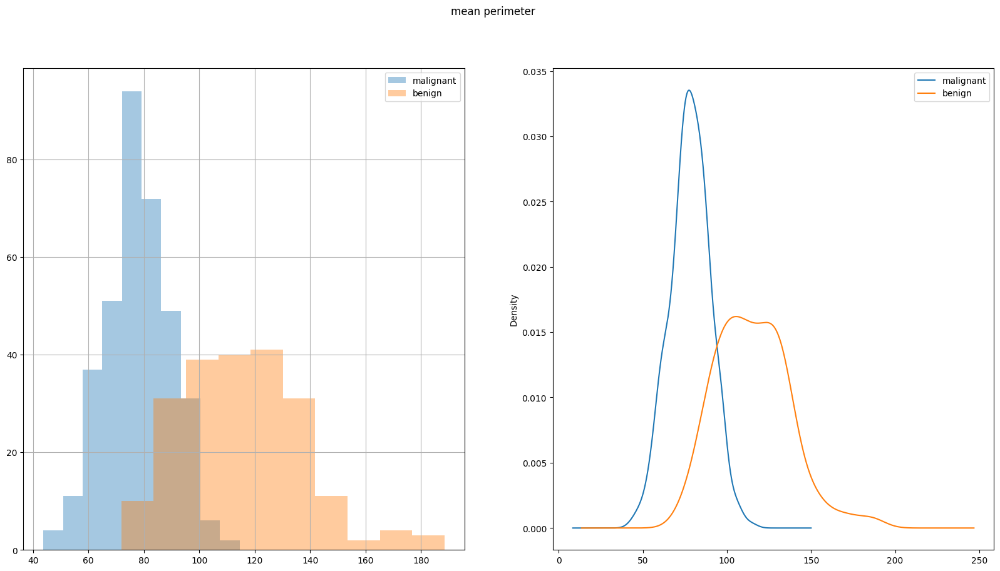

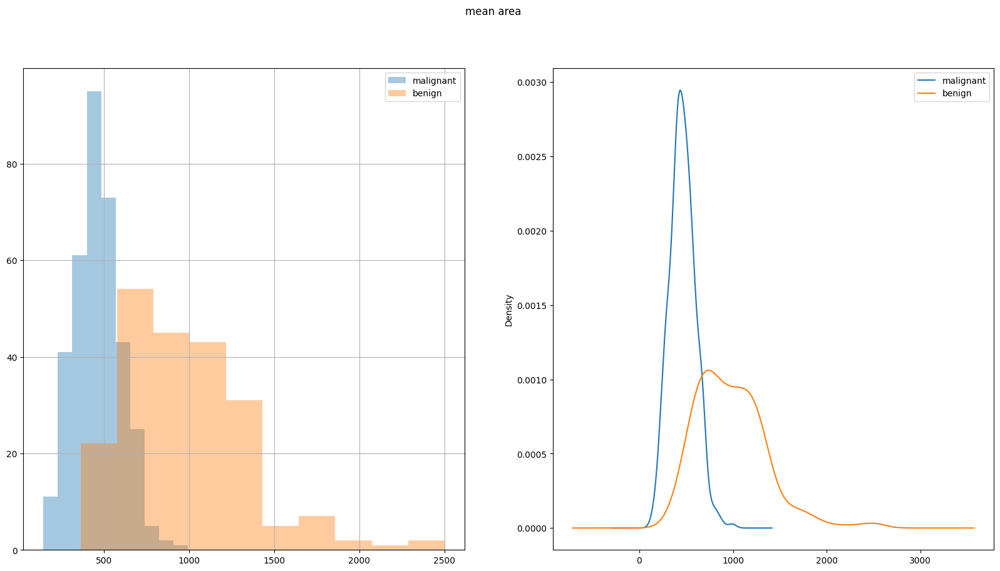

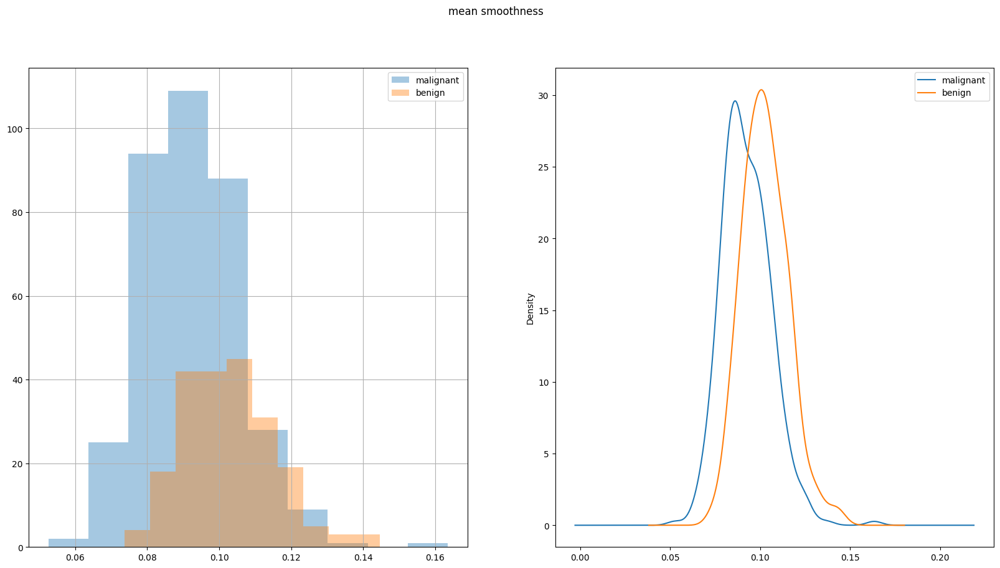

...

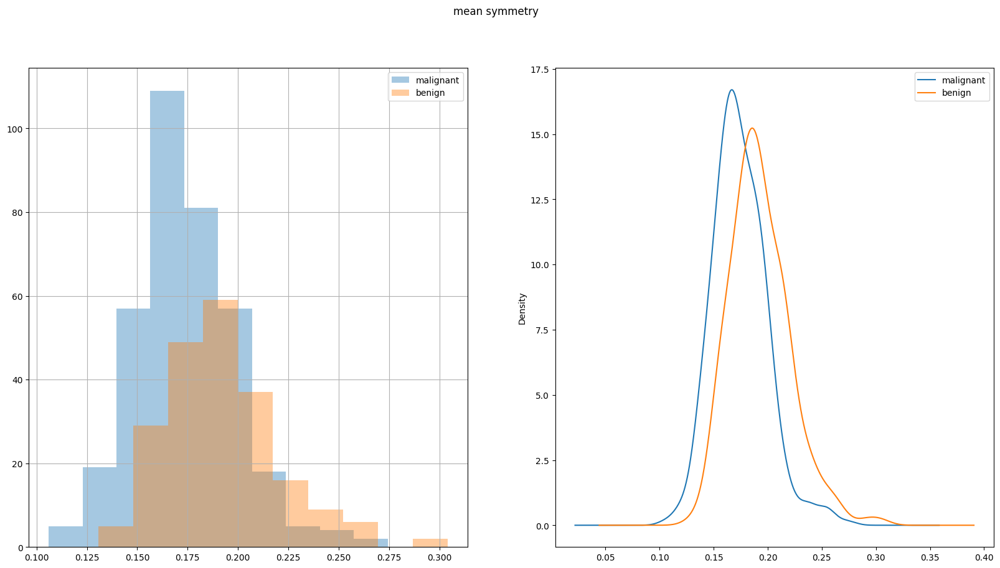

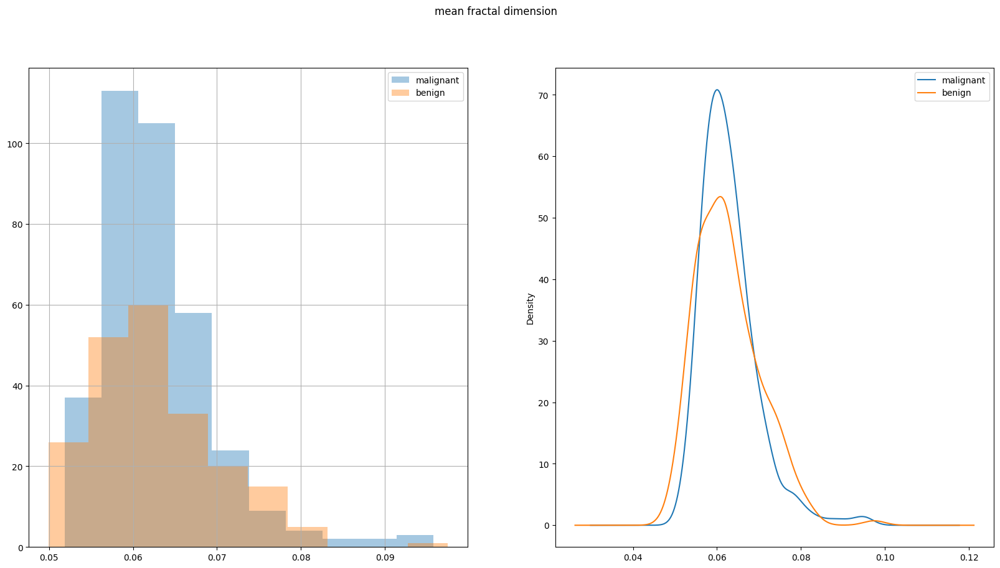

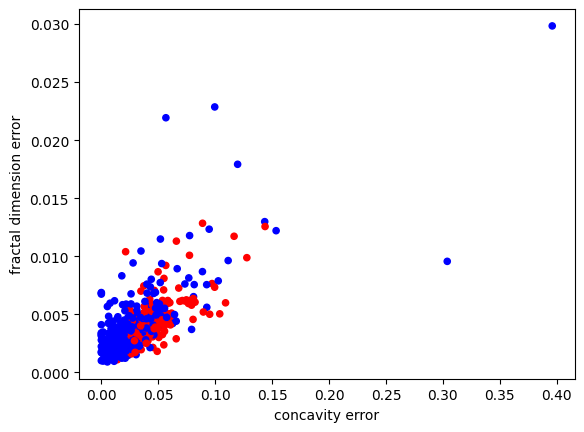

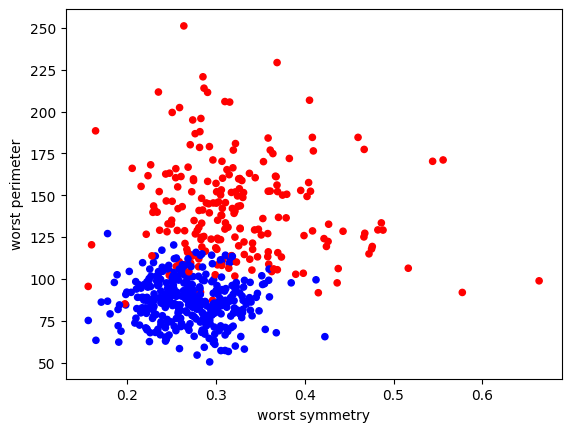

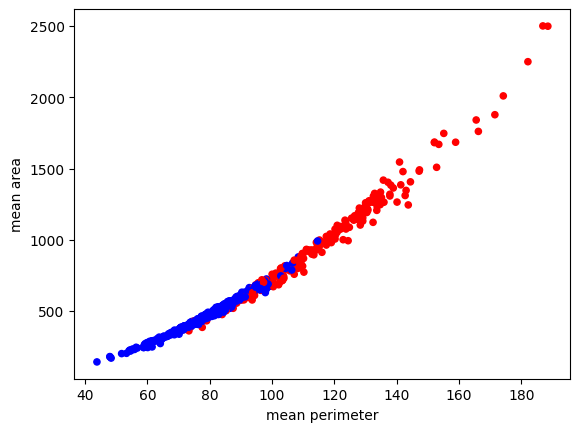

In [14]:
%matplotlib inline
from matplotlib.patches import Rectangle

y_train_l= [bcd.target_names[l] for l in bcd.target]
color= ['red' if l == 0 else 'blue' for l in bcd.target]
#bc_df.hist(by=y_train_l,column="mean radius",alpha=0.4)

for feature in bcd.feature_names[:10]: # only the first 10 features
    fig,axs = plt.subplots(ncols=2, figsize=(20, 10))
    fig.suptitle(feature)
    
    bc_df.groupby(by=y_train_l)[feature].hist(alpha=0.4,ax=axs[0])
    bc_df.groupby(by=y_train_l)[feature].plot(kind='kde',ax=axs[1])
    axs[1].legend(bcd.target_names)
    axs[0].legend(bcd.target_names)

bc_df.plot(x="concavity error",y="fractal dimension error",c=color, kind="scatter")
bc_df.plot(x="worst symmetry",y="worst perimeter",c=color, kind="scatter")
bc_df.plot(x="mean perimeter",y="mean area",c=color, kind="scatter")

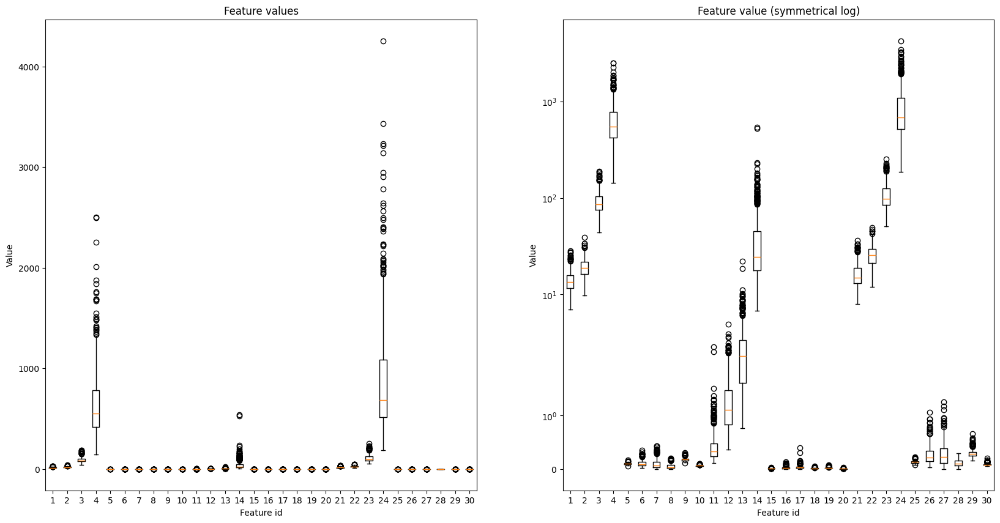

In [15]:
%matplotlib inline

plt.figure(figsize=(20,10))
ax = plt.subplot(121)
ax.set_title("Feature values")
ax.boxplot(bcd.data)
ax.set_xlabel("Feature id")
ax.set_ylabel("Value")

ax = plt.subplot(122)
ax.set_title("Feature value (symmetrical log)")
ax.boxplot(bcd.data)
plt.yscale("symlog")
ax.set_xlabel("Feature id")
ax.set_ylabel("Value");





# Classification

Recall that in a classification problem the aim is to build a model that will be able to correctly predict the class, i.e. label, for a given input. In a binary classification the choice has to be made among two classes. In the general setting, called multiclass classification, the set of classes has a size greater than 2.

This section will introduce our first supervised learning algorithm considering a binary classification setting. We will use the breast cancer dataset just introduced. Using this dataset we aim at predicting if a tumor is malignant or not.

In [16]:
from sklearn.datasets import load_breast_cancer
bcd = load_breast_cancer() 

In [17]:
bcd.target_names[1]

'benign'

## Preparing the dataset

**IMPORTANT** : the main aim of supervised machine learning is to define a model generalizing the training data: we want to obtain a model able to perform good predictions on new inputs (and not to memorize the training set) - this must be clear for you now.

In order to criticize our model, we therefore want to evaluate it on fresh inputs for which we know the expected outputs, i.e. labeled inputs that have not been used for building the model.
The easiest way to do so is to split the given training set into two subsets: 
* The training set: set of examples we will use for building the model.
* The test set: set of examples we will use testing the model.

More elaborated approaches will be used later (e.g. k-fold validation). Let's consider for now that we only consider those two sets.

Scikit-learn provides an easy way to split your dataset into training and test sets (cf [documentation](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html)). Specific parameters can be used to define how to split the dataset, e.g. you can specify the size of the test set (equal to 33% in the provided example):

In [18]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(bcd.data, bcd.target, test_size=0.33)

Intuitively, X_train contains the examples of inputs we will use to train our model. y_train stores the expected labels for those examples. Respectively, X_test and y_test store the test exemples and their labels.

In [19]:
print(f"X_train shape: {X_train.shape}")
print(f"y_train shape: {y_train.shape}")
print(f"X_test shape: {X_test.shape}")
print(f"y_test shape: {y_test.shape}")

X_train shape: (381, 30)
y_train shape: (381,)
X_test shape: (188, 30)
y_test shape: (188,)



**IMPORTANT**: 
We will now only consider the training set to study our problem and to build the classifier. Using the test set would be cheating; even only performing descriptive analysis. We have to be careful since using the test set could impact the conclusion we would obtain, e.g. by underestimating the evaluation of the performance of our model - It would be like if you were evaluating your skills in a specific area by studying the exam questions. Note for instance that normalizing the input values considering the test set would be an error.


**NOTE**: The tests performed to obtain the metrics may be costly or invasive.
    It would therefore be interesting to reduce their number in order to perform them only if they add value for predicting the outcome. What would you recommend to distinguish the features to use if you had to only consider a subset of the dimensions? Which type of Machine learning setting could we consider to provide insight to this question?

## Linear classification

We will first use a linear model adapted to perform classification. 

**NOTE**: You should now be able to name a linear model adapted to perform classification.

Let's consider logistic regression for now - do not be mislead by its name, logistic regression is a model that is used for classification and not regression...

Please read and try to understand the example provided below.

An overcommented version is next provided (try understanding it by yourself first) 

In [20]:
from sklearn.linear_model import LogisticRegression

clf_lr = LogisticRegression(solver='lbfgs', max_iter=5000) 
clf_lr.fit(X_train, y_train) 

print(f"intercept: {clf_lr.intercept_}")
print(f"weights:   {clf_lr.coef_}")

t = X_test[:1,:] # build array only containing the first example from test using slicing
pred = clf_lr.predict(t) 
pred_pr = clf_lr.predict_proba(t) 

t_pred = pred[0]
t_pred_pr = pred_pr[0]
print(f"Prediction: {t_pred}, probability: {t_pred_pr[t_pred]}")


# Let's compute the error the model performs on the training and test sets
# We can use the score() function to do so
train_score = clf_lr.score(X_train,y_train)
test_score = clf_lr.score(X_test,y_test)

print(f"Training set score: {train_score:.2f} ")
print(f"Test set score: {test_score:.2f} ")


intercept: [20.12427916]
weights:   [[ 1.07654619  0.07946123 -0.06365749  0.01763998 -0.11740326 -0.19006127
  -0.35665879 -0.17038829 -0.17193716 -0.03278137  0.01083765  0.75739072
   0.39838479 -0.10879878 -0.02164358 -0.04194841 -0.09930563 -0.03854167
  -0.04539734 -0.00889759  0.9505167  -0.34503595 -0.28386815 -0.01897281
  -0.20570961 -0.46298092 -0.89770748 -0.33355318 -0.48797871 -0.08096324]]
Prediction: 1, probability: 0.9436041023800117
Training set score: 0.97 
Test set score: 0.94 


Additional comments

In [21]:
# we import LogisticRegression from linear model
from sklearn.linear_model import LogisticRegression

# We instantiate the model specifying which solver we want to use to find the parameters
# clf = classifier lr = logistic regression
# max_iter is a hyperparameter used to configure the solver 
clf_lr = LogisticRegression(solver='lbfgs', max_iter=5000) 

# Like all supervised models implemented in scikit-learn, 
# we can fit the model to provided labeled data.
# Fitting means minimizing an error considering a specific error function and algorithm
clf_lr.fit(X_train, y_train) 

# Here are the parameters
print("intercept: {}".format(clf_lr.intercept_))
print("weights:   {}".format(clf_lr.coef_))

# The training phase may output a warning generated by the solver
# Nothing to be scared about, read it, understand it. 

# Here it goes, the model is trained. 
# It means that we can now use the model to predict the class for any new input
# Note that you can use the following one-liner to both create and train the classifier:
# clf_lr = LogisticRegression(solver='lbfgs').fit(X_train, y_train) 

# Example of prediction
t = X_test[:1,:] # build array only containing the first example from test using slicing
pred = clf_lr.predict(t) # predict() requires n-dimensional array
pred_pr = clf_lr.predict_proba(t) 

t_pred = pred[0]
t_pred_pr = pred_pr[0]
print("Prediction: {}, probability: {}".format(t_pred,t_pred_pr[t_pred]))


# Let's compute the error the model performs on the training and test sets
# We can use the score() function to do so
train_score = clf_lr.score(X_train,y_train)
test_score = clf_lr.score(X_test,y_test)

print("Training set score: {:.2f} ".format(train_score))
print("Test set score: {:.2f} ".format(test_score))



intercept: [20.12427916]
weights:   [[ 1.07654619  0.07946123 -0.06365749  0.01763998 -0.11740326 -0.19006127
  -0.35665879 -0.17038829 -0.17193716 -0.03278137  0.01083765  0.75739072
   0.39838479 -0.10879878 -0.02164358 -0.04194841 -0.09930563 -0.03854167
  -0.04539734 -0.00889759  0.9505167  -0.34503595 -0.28386815 -0.01897281
  -0.20570961 -0.46298092 -0.89770748 -0.33355318 -0.48797871 -0.08096324]]
Prediction: 1, probability: 0.9436041023800117
Training set score: 0.97 
Test set score: 0.94 




---

**INFO**: The training phase may generate a ConvergenceWarning specifying that 'lbfgs (the solver we used) failed to converge. Increase the number of iterations.'. This is not very important for now. You can try to understand what it means, and eventually think about how to fix this. Keep in mind however that algorithms used to solve problems have to be monitored in practice.

---

Using logistic regression we have obtained a classifier with a test error around 0.94; not that bad for a first try. Note that the quality of the classifier can only be discussed w.r.t the application context, i.e. it's up to you to decide if such a performance is enough considering the future usage of the classifier.

In the provided example we used logistic regression to deal with a classification problem. Using this example, we have seen that it is quite simple to train a model to further use it for predicting output values (i.e. targets) for new inputs. Scikit-learn provides a unified interface for all supervised learning models that can be used to deal with classification and/or regression: 

* The method *fit* can be used to train the model. Depending on the model you, use specific parameters can be provided to configure the model in the constructor, i.e. to define hyperparameters that will be used by the model or to build the model. As an example, using logistic regression, we have defined the solver to use to derive the optimal parameters.

* The method *predict* enables to use a trained model for predicting outputs for new inputs. In some case, additional methods can be used to retrieve additional information computed (or that can be derived) by the algorithm; using logistic regression in a classification setting we are for instance able to access the predicted probabilities in addition to the assigned classes (using the predict_proba method).

* The method *score* enables to compute the performance of the model on a specific subset of the dataset. 


The various models that can be used for classification and regression are specified in the <a href='https://scikit-learn.org/stable/user_guide.html'>scikit-learn documentation</a>. It is quite easy to get lost in front of the wide diversity of existing approaches. You'll get familiar to them, and gradually learn how to prefer an approach depending on the problem you'll have to deal with. It will also be part of your work to test various settings in order to distinguish the best approach. 


Let's  go back to our logistic regression example. We now want to analyze what's happening by focusing on a subset of the dataset only considering two dimensions. More specifically, we would like to visualize the decision boundary computed using logistic regression.



---

**EXERCISE 2** 

Reduce the dataset in order to restrict your analysis to two features, e.g. 'worst symmetry' and 'worst perimeter'. 

Train a logistic regression model on the modified training set.

Finally use its parameters to define the equation of the hyperplane corresponding to the decision boundary. Finally, use matplotlib to plot the decision boundary as well the training and test sets (use light colors for training data).

Recommended steps: 

1.   Compute the decision boundary, i.e. the equation separating the two classes (we are here dealing with a linear classifier) 
2.   Plot the decision boundary
3.   Plot the training and test data. 

Tips: 

*   The decision boundary is in this case the line such as $w_1 x_1 + w_2 x_2 + b = 0$
*   You can access the values of the parameters using the model attributes `coef` (for $w_1, w_2$) and `intercept_ for`  $b$
* The following code can be used to start your plot. It plots a line and the first 10 input elements from X coloring them according to their class.

---

(10,)


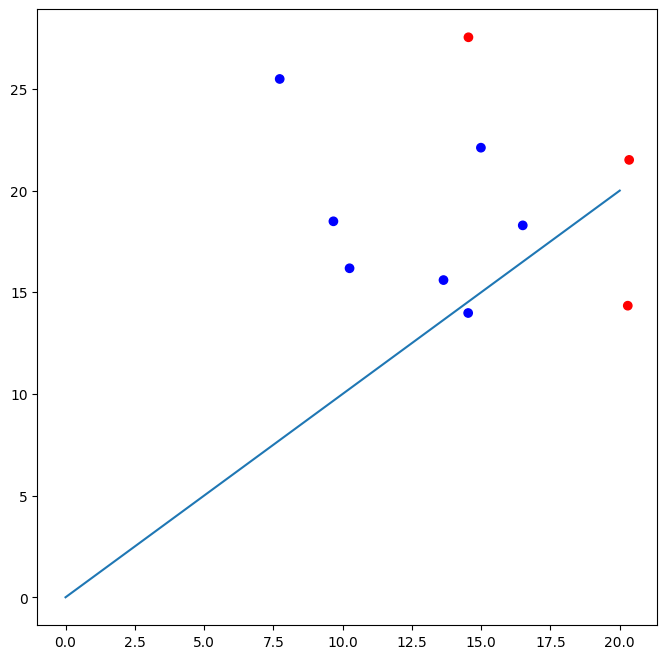

In [24]:
import matplotlib

print(X_train[:10,0].shape)
fig = plt.figure(figsize=(8,8))
plt.plot([0, 20], [0, 20]) # plot a line 
plt.scatter(X_train[:10,0], X_train[:10,1], c=y_train[:10], cmap=matplotlib.colors.ListedColormap(['red','blue']))

Training set score: 0.92 
Test set score: 0.90 
intercept: [19.04867269]
weights:   [[-1.54952697 -0.16836081]]
[0.131135 0.689165] [111.93504655 106.79915703]
(188, 2) (381, 2) (381,)
[[2.227e-01 7.010e+01]
 [2.406e-01 8.883e+01]
 [2.597e-01 7.651e+01]
 [3.390e-01 8.123e+01]
 [2.196e-01 9.669e+01]
 [2.226e-01 8.900e+01]
 [3.074e-01 1.422e+02]
 [2.369e-01 1.291e+02]
 [3.080e-01 1.116e+02]
 [2.933e-01 7.539e+01]
 [4.761e-01 1.194e+02]
 [2.964e-01 8.722e+01]
 [3.512e-01 1.263e+02]
 [2.487e-01 1.045e+02]
 [2.593e-01 2.024e+02]
 [2.048e-01 9.199e+01]
 [3.019e-01 1.243e+02]
 [2.432e-01 8.738e+01]
 [3.053e-01 1.114e+02]
 [1.652e-01 6.334e+01]
 [2.404e-01 1.046e+02]
 [3.828e-01 1.720e+02]
 [3.444e-01 1.605e+02]
 [2.639e-01 1.050e+02]
 [4.724e-01 1.150e+02]
 [2.781e-01 8.692e+01]
 [3.343e-01 8.493e+01]
 [3.215e-01 1.017e+02]
 [3.062e-01 1.104e+02]
 [3.010e-01 1.521e+02]
 [1.999e-01 9.212e+01]
 [2.660e-01 8.814e+01]
 [2.826e-01 9.067e+01]
 [2.518e-01 9.578e+01]
 [1.859e-01 9.790e+01]
 [3.258e-0

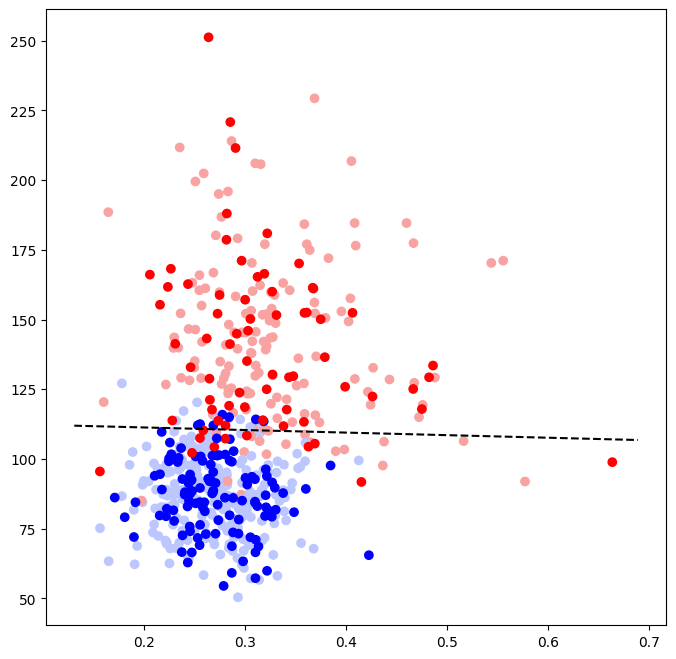

In [30]:
# TODO

import matplotlib
from sklearn.linear_model import LogisticRegression

features = ['worst symmetry','worst perimeter']
# here we do not check if the provided feature name are correct, be careful if you change the feature names
# we retrieve the index of the feature name, i.e. index of the column corresponding to the features
idx = [np.where(bcd.feature_names==f)[0][0] for f in features]

X_train_reduced = X_train[:, idx]
X_test_reduced = X_test[:, idx]
# note that y_train and y_test are unchanged

clf_lr = LogisticRegression(solver='lbfgs').fit(X_train_reduced, y_train)

train_score = clf_lr.score(X_train_reduced,y_train)
test_score = clf_lr.score(X_test_reduced,y_test)

print("Training set score: {:.2f} ".format(train_score))
print("Test set score: {:.2f} ".format(test_score))

fig = plt.figure(figsize=(8,8))
plt.scatter(X_train_reduced[:,0], X_train_reduced[:,1], c=y_train, cmap=matplotlib.colors.ListedColormap(['#f9a2a2','#bcc6ff']))# light red/blue
plt.scatter(X_test_reduced[:,0], X_test_reduced[:,1], c=y_test, cmap=matplotlib.colors.ListedColormap(['red','blue']))

# Here are the parameters
print("intercept: {}".format(clf_lr.intercept_))
print("weights:   {}".format(clf_lr.coef_))

w_1 = clf_lr.coef_[0][0]
w_2 = clf_lr.coef_[0][1]
b = clf_lr.intercept_[0]
# the decision boundary is of the form: w_1 * x_1 + w_2 * x_2 + b = 0
# To draw it we therefore need to express x_2 in terms of x_1; we obtain:
# x_2 = -(w_1 * x_1 + b)/w_2
x_1_vals = np.array(plt.gca().get_xlim()) # only two points are required to draw a line, get min/max on x axis (gca=get current axes)
x_2_vals = -(w_1 * x_1_vals  + b)/w_2
plt.plot(x_1_vals, x_2_vals, '--', c="black")
print(x_1_vals,x_2_vals)
print(X_test_reduced.shape, X_train_reduced.shape,y_train.shape)
print(X_train_reduced[10:])

**Do not read before solving the exercise above.** 

Since logistic regression provides a probability, we can provide more information than a simple decision boundary.
We can indeed plot the probability distribution $P(Y=malignant|X)$.

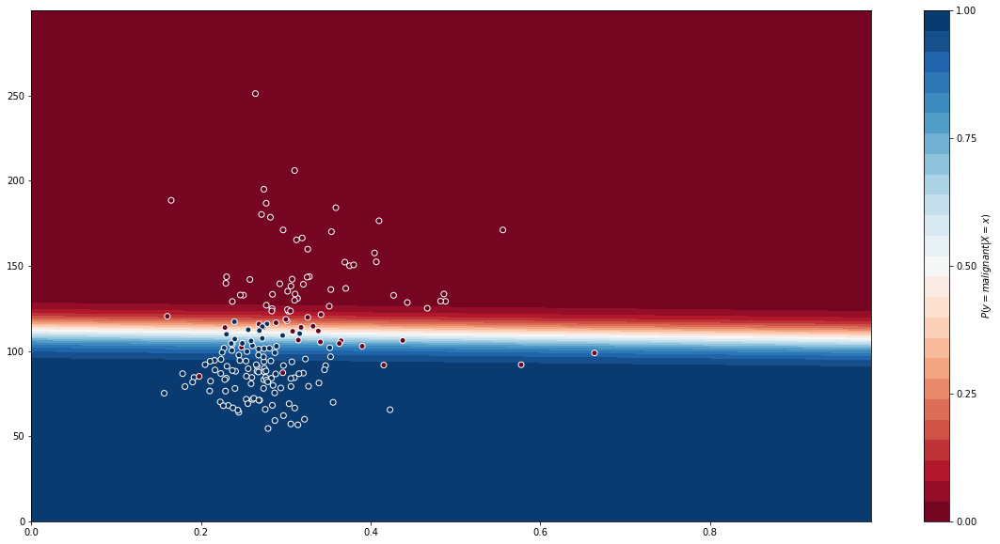

In [ ]:
xx, yy = np.mgrid[0:1:.01, 0:300:.01] # we divide the space into tiny areas for which we will estimate the probability that a vector in that subspace will be classified as positive
grid = np.c_[xx.ravel(), yy.ravel()] # c_ translates slice objects to concatenation along the second axis (technical).


features = ['worst symmetry','worst perimeter']
idx = [np.where(bcd.feature_names==f)[0][0] for f in features]

X_train_reduced = X_train[:, idx]
X_test_reduced = X_test[:, idx]

clf_lr = LogisticRegression(solver='lbfgs').fit(X_train_reduced, y_train)

probs = clf_lr.predict_proba(grid)[:, 1].reshape(xx.shape) # get the probabilities as estimated by the classifier

fig, ax = plt.subplots(figsize=(20, 10))
contour = ax.contourf(xx, yy, probs, 25, cmap="RdBu",
                      vmin=0, vmax=1)
ax_c = fig.colorbar(contour)
ax_c.set_label("$P(y = malignant | X=x)$")
ax_c.set_ticks([0, .25, .5, .75, 1])

ax.scatter(X_test_reduced[:,0], X_test_reduced[:,1], c=y_test, 
           cmap="RdBu", vmin=0, vmax=1,
           edgecolor="white", linewidth=1)

#ax.set(aspect="equal", xlim=(0, 1), ylim=(0, 300), xlabel="$X_1$", ylabel="$X_2$")

<ipython-input-26-827b1d3e5bd9>:49: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  fig.add_axes(ax)


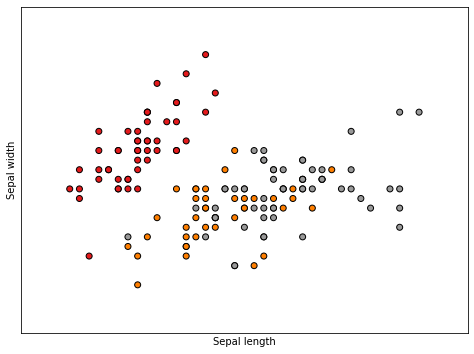

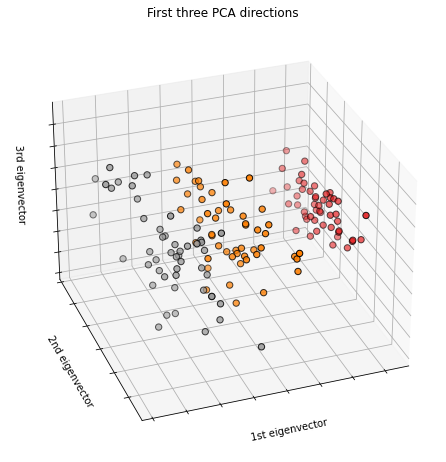

In [ ]:
# From https://scikit-learn.org/stable/auto_examples/datasets/plot_iris_dataset.html
# Code source: Gaël Varoquaux
# Modified for documentation by Jaques Grobler
# License: BSD 3 clause

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn import datasets
from sklearn.decomposition import PCA

# import some data to play with
iris = datasets.load_iris()
X = iris.data[:, :2]  # we only take the first two features.
y = iris.target

x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5

plt.figure(2, figsize=(8, 6))
plt.clf()

# Plot the training points
plt.scatter(X[:, 0], X[:, 1], c=y, cmap=plt.cm.Set1,
            edgecolor='k')
plt.xlabel('Sepal length')
plt.ylabel('Sepal width')

plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())


# To getter a better understanding of interaction of the dimensions
# plot the first three PCA dimensions
fig = plt.figure(1, figsize=(8, 6))
ax = Axes3D(fig, elev=-150, azim=110)
X_reduced = PCA(n_components=3).fit_transform(iris.data)
ax.scatter(X_reduced[:, 0], X_reduced[:, 1], X_reduced[:, 2], c=y,
           cmap=plt.cm.Set1, edgecolor='k', s=40)
ax.set_title("First three PCA directions")
ax.set_xlabel("1st eigenvector")
ax.w_xaxis.set_ticklabels([])
ax.set_ylabel("2nd eigenvector")
ax.w_yaxis.set_ticklabels([])
ax.set_zlabel("3rd eigenvector")
ax.w_zaxis.set_ticklabels([])

fig.add_axes(ax)

plt.show()

---

**EXERCISE 3** 

Muticlass setting: analyse the behaviour of Logistic Regression on the iris dataset included in the sklearn datasets. Discuss the performance of the algorithm on both training and test sets.

---

In [ ]:
# TODO
# loading the iris dataset
from sklearn import datasets

iris = datasets.load_iris()
  
# X -> features, y -> label
X = iris.data
y = iris.target
  
# dividing X, y into train and test data
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 0)
  
clf_lr = LogisticRegression(solver='lbfgs', max_iter=5000, multi_class='auto').fit(X_train, y_train)

train_score = clf_lr.score(X_train,y_train)
test_score = clf_lr.score(X_test,y_test)

print(f"Train score: {train_score}")
print(f"Test score : {test_score}")




Train score: 0.9821428571428571
Test score : 0.9736842105263158


---

**EXERCISE 4** 

Use a classification Tree model.

---

In [ ]:
# TODO

from sklearn.tree import DecisionTreeClassifier

dtree_model = DecisionTreeClassifier(max_depth = 2).fit(X_train, y_train)
dtree_predictions = dtree_model.predict(X_test)

train_score = dtree_model.score(X_train,y_train)
test_score = dtree_model.score(X_test,y_test)

print(f"Train score: {train_score}")
print(f"Test score : {test_score}")

Train score: 0.9642857142857143
Test score : 0.8947368421052632


# Regression

We will know deal with a regression problem using the Boston house prices dataset that can be loaded from Scikit-learn.

In [ ]:
from sklearn.datasets import load_boston
bhpd = load_boston() # bhpd stands for Boston house prices dataset
print("Keys of Boston house prices dataset: {}".format(bhpd.keys()))
print("Keys of Boston house prices dataset: {}".format(bhpd.DESCR))

Keys of Boston house prices dataset: dict_keys(['data', 'target', 'feature_names', 'DESCR', 'filename'])
Keys of Boston house prices dataset: .. _boston_dataset:

Boston house prices dataset
---------------------------

**Data Set Characteristics:**  

    :Number of Instances: 506 

    :Number of Attributes: 13 numeric/categorical predictive. Median Value (attribute 14) is usually the target.

    :Attribute Information (in order):
        - CRIM     per capita crime rate by town
        - ZN       proportion of residential land zoned for lots over 25,000 sq.ft.
        - INDUS    proportion of non-retail business acres per town
        - CHAS     Charles River dummy variable (= 1 if tract bounds river; 0 otherwise)
        - NOX      nitric oxides concentration (parts per 10 million)
        - RM       average number of rooms per dwelling
        - AGE      proportion of owner-occupied units built prior to 1940
        - DIS      weighted distances to five Boston employment centres


---

**EXERCISE 5** 

Use Linear regression to build a regression model

---

Training set score: 0.77
Test set score: 0.64


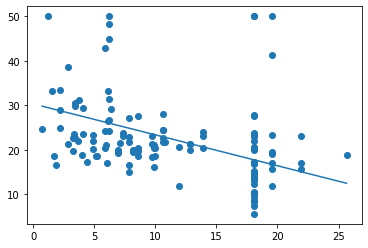

In [ ]:
# TODO

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(bhpd.data, bhpd.target, random_state=0)
lr = LinearRegression().fit(X_train,y_train)

print("Training set score: {:.2f}".format(lr.score(X_train,y_train)))
print("Test set score: {:.2f}".format(lr.score(X_test,y_test)))

i_feature = 2

X_train_ = X_train[:, i_feature]

lr = LinearRegression().fit(X_train_[..., None],y_train)

theta = lr.coef_.copy()
theta = np.insert(theta, 0, lr.intercept_)

min_val = X_test[:, i_feature].min()
max_val = X_test[:, i_feature].max()


x_ = np.linspace(start=min_val, stop=max_val, num=100)
y_pred_ = theta[0] + theta[1] * x_

plt.scatter(X_test[:, i_feature], y_test, label="target")
plt.plot(x_, y_pred_, label="prediction")

---

**EXERCISE 6**         
Evaluate several experimental feature transformations and compare the results. Use K-fold cross validation for this comparison.

Refer respectively to:
* `from sklearn.preprocessing import PolynomialFeatures` 
* `from sklearn import model_selection`, `model_selection.KFold` and `model_selection.cross_validate`

---

In [ ]:
# TODO

from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(2)
X_pol = poly.fit_transform(bhpd.data)
print(bhpd.data.shape, X_pol.shape)

X_train_pol, X_test_pol, y_train_pol, y_test_pol = train_test_split(X_pol, bhpd.target, random_state=0)
lr_pol = LinearRegression().fit(X_train_pol,y_train_pol)

print("Training set score: {:.2f}".format(lr_pol.score(X_train_pol,y_train_pol)))
print("Test set score: {:.2f}".format(lr_pol.score(X_test_pol,y_test_pol)))

(506, 13) (506, 105)
Training set score: 0.92
Test set score: 0.55


In [ ]:
from sklearn import model_selection
from sklearn import linear_model

kfold = model_selection.KFold(n_splits=5, shuffle=True, random_state=12345)

cv_results = model_selection.cross_validate(lr, X_train, y_train, cv=kfold)
cv_results_pol = model_selection.cross_validate(lr_pol, X_train_pol, y_train_pol, cv=kfold)

print("Ordinary Least Square Model (OLS)         ", cv_results['test_score'].mean())
print("OLS + polynomial features                 ", cv_results_pol['test_score'].mean())

# Let's try using polynomial features with regularization
lr_reg = linear_model.Ridge(alpha=.5).fit(X_train_pol,y_train_pol)
cv_results_reg = model_selection.cross_validate(lr_reg, X_train_pol, y_train_pol, cv=kfold)


print("OLS + Regularization + polynomial features", cv_results_reg['test_score'].mean())

Ordinary Least Square Model (OLS)          0.7174726623675569
OLS + polynomial features                  0.6160590531226205
OLS + Regularization + polynomial features 0.7963967932734446


Have a look to Pipelines 

In [ ]:
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
X, y = make_classification(random_state=0)
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
pipe = Pipeline([('scaler', StandardScaler()), ('svc', SVC())])
pipe.fit(X_train, y_train)
Pipeline(steps=[('scaler', StandardScaler()), ('svc', SVC())])
pipe.score(X_test, y_test)

0.88

Have a look to the diversity of models implemented in Sklearn: https://scikit-learn.org/stable/supervised_learning.html 